In [12]:
import math
import numpy as np
from tqdm import tqdm
from PIL import Image
import matplotlib.pyplot as plt

import torch
import torchvision
import torch.nn.functional as F
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms as transforms
from torch.utils.data import DataLoader
import torchvision.datasets as datasets
from torchvision.transforms import ToPILImage
from torch.utils.tensorboard import SummaryWriter


device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(device)

cuda


## Data Augmentation

In [13]:
transform = transforms.Compose([
    transforms.Resize((64, 64)),  # Asegura el tamaño
    transforms.RandomHorizontalFlip(p=0.5),   # Flip horizontal aleatorio
    transforms.RandomRotation(degrees=15),    # Rotación aleatoria
    transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1),  # Variación de color
    transforms.RandomAffine(degrees=0, translate=(0.05, 0.05)),  # Pequeños desplazamientos
    transforms.ToTensor(),
    transforms.Normalize([0.5]*3, [0.5]*3)     # Normalización a [-1, 1]
])

In [14]:
def load_dataset(image_dir, batch_size=32, shuffle=True):
    dataset = datasets.ImageFolder(image_dir, transform=transform)
    loader = DataLoader(dataset, batch_size=batch_size, shuffle=shuffle)
    return loader

## Revertir imagen para mostrarla

In [15]:
def reverse_transforms(image):
    reverse_transforms = transforms.Compose([
        transforms.Lambda(lambda t: (t + 1) / 2), #Rescale the tensor values from [-1, 1] to [0, 1]
        transforms.Lambda(lambda t: t.permute(1, 2, 0)), ##CHW to HWC  (3, 32, 32) -> (32, 32, 3)
        transforms.Lambda(lambda t: t * 255.), #Scale the tensor values from [0, 1] to [0, 255]
        transforms.Lambda(lambda t: t.numpy().astype(np.uint8)),   #Convert the tensor to a numpy array and change its data type to unsigned 8-bit integers
        transforms.ToPILImage(),  #transform numpy array to PIL Image
    ])

    if len(image.shape) == 4:
        image = image[0, :, :, :]
    return reverse_transforms(image)

## Proceso de difusión

In [16]:
class Forward_diffussion_process():
  def __init__(self, start, end, timesteps):
    self.start = start
    self.end = end
    self.steps = timesteps

  def noise_scheduler(self):
    beta = torch.linspace(self.start, self.end, self.steps)
    return beta

  def get_index(self, values, t, x_shape):  ##x_shape - shape of input images (32, 3, 64, 64)  (N - batch_size, channels, height, width)
    batch_size = t.shape[0] 
    out = values.gather(-1, t.cpu())  #gather aplha_bar_t th index from alpha cumprod, from last-dim
    #print(out)
    return out.reshape(batch_size, *((1,) * (len(x_shape) - 1))).to(t.device)

  def mean_var_helper(self):  ##to get posterior variance and mean for sampling   [bar <=> cumprod]
    #Posterior variance
    beta = self.noise_scheduler()
    alpha = 1. - beta
    alpha_cumprod = torch.cumprod(alpha, axis=0)  #alpha_bar
    alpha_cumprod_shifted = F.pad(alpha_cumprod[:-1], (1, 0), value=1.0)  #alpha_bar_t_minus_one
    sqrt_recip_alpha = torch.sqrt(1.0 / alpha)  #1/sqrt(alpha)
    sqrt_alpha_cumprod = torch.sqrt(alpha_cumprod)  #sqrt(alpha_bar)
    sqrt_one_minus_alpha_cumprod = torch.sqrt(1. - alpha_cumprod) #sqrt(1- alpha_bar)|

    posterior_variance = beta * (1. - alpha_cumprod_shifted) / (1. - alpha_cumprod)
    return posterior_variance, sqrt_recip_alpha, beta, sqrt_one_minus_alpha_cumprod


  def forward_diffusion_sample(self, input_image, t):
    ##gaussian noise
    epsilon = torch.randn_like(input_image).to(device)
    beta = self.noise_scheduler()
    alpha = 1. - beta
    alpha_cumprod = torch.cumprod(alpha, axis=0)  #alpha_bar
    sqrt_alpha_cumprod = torch.sqrt(alpha_cumprod)  #sqrt(aplha_t)
    sqrt_one_minus_alpha_cumprod = torch.sqrt(1.0 - alpha_cumprod) #sqrt(1 - aplha_t)
    sqrt_acp_at_t = self.get_index(sqrt_alpha_cumprod,
                                   t,
                                   input_image.shape,).to(device)

    sqrt_one_minus_acp_at_t = self.get_index(sqrt_one_minus_alpha_cumprod,
                                   t,
                                   input_image.shape).to(device)
    ##xt = (Input_image) * sqrt(alphas_cumprod (till timestep t)) + (sqrt(1-alphas_cumprod (till timestep t))) * epsilon, epsilon ~ N(0,1)

    return sqrt_acp_at_t * input_image + sqrt_one_minus_acp_at_t * epsilon, epsilon

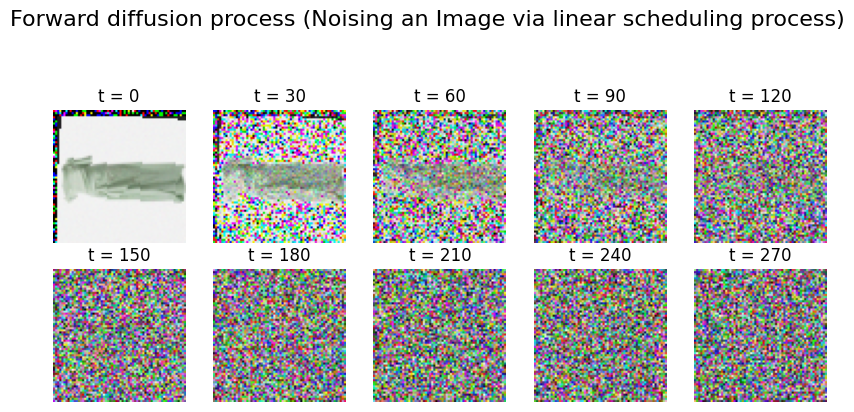

In [18]:
T = 300
path = "/kaggle/input/"
dataloader = load_dataset(path)
fdp = Forward_diffussion_process(0.0001, 0.02, T)
images, _ = next(iter(dataloader))
input_image = images[0].permute(1, 2, 0)

plt.figure(figsize=(10, 10))

for idx, i in enumerate(range(0, 300, 30)):
  t = torch.tensor([i]).type(torch.int64)
  noisified_image, _ = fdp.forward_diffusion_sample(input_image.to(device), t)
  #print(noisified_image.shape)
  plt.subplot(5, 5, idx + 1)
  img = reverse_transforms(noisified_image.detach().cpu().permute(2, 1, 0))
  plt.imshow(img)
  plt.title(f't = {t.item()}')
  plt.axis('off')

plt.suptitle("Forward diffusion process (Noising an Image via linear scheduling process)", fontsize=16)
plt.show()

In [19]:
class TimeEmbeddings(nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.dim = dim

    def forward(self, time):
        device = time.device
        half_dim = self.dim // 2
        embeddings = math.log(10000) / (half_dim - 1)
        embeddings = torch.exp(torch.arange(half_dim, device=device) * -embeddings)
        embeddings = time[:, None] * embeddings[None, :]
        embeddings = torch.cat((embeddings.sin(), embeddings.cos()), dim=-1)
        return embeddings

## U-NET

In [29]:
class Block(nn.Module):
    def __init__(self, in_ch, out_ch, time_emb_dim, up=False):
        super().__init__()
        self.time_mlp =  nn.Linear(time_emb_dim, out_ch)
        if up:
            self.conv1 = nn.Conv2d(2*in_ch, out_ch, 3, padding=1)
            self.transform = nn.ConvTranspose2d(out_ch, out_ch, 4, 2, 1)
        else:
            self.conv1 = nn.Conv2d(in_ch, out_ch, 3, padding=1)
            self.transform = nn.Conv2d(out_ch, out_ch, 4, stride = 2, padding= 1)
        self.conv2 = nn.Conv2d(out_ch, out_ch, 3, padding=1)
        self.bnorm1 = nn.BatchNorm2d(out_ch)
        self.bnorm2 = nn.BatchNorm2d(out_ch)
        self.relu  = nn.ReLU()

    def forward(self, x, t, ):
        h = self.bnorm1(self.relu(self.conv1(x)))
        time_emb = self.relu(self.time_mlp(t))
        time_emb = time_emb[..., None, None]
        h = h + time_emb
        return self. transform(h)

In [30]:
class Unet(nn.Module):
    """
    A simplified variant of the Unet architecture.
    """
    def __init__(self):
        super().__init__()
        image_channels = 3
        down_channels = (64, 128, 256, 512, 1024)
        up_channels = (1024, 512, 256, 128, 64)
        out_dim = 3
        time_emb_dim = 32

        # Time embedding
        self.time_embed = nn.Sequential(
                TimeEmbeddings(time_emb_dim), #o/p: (64,32) position embeddings
                nn.Linear(time_emb_dim, time_emb_dim), #inputs: (64,32), outputs: (64,32)
                nn.ReLU()
            )

        self.conv0 = nn.Conv2d(image_channels, down_channels[0], 3, padding=1)  ##output after this layer: (64 or 32, 3, 64, 64)


        self.downs = nn.ModuleList([Block(down_channels[i], down_channels[i+1], \
                                    time_emb_dim) \
                    for i in range(len(down_channels)-1)])

        self.ups = nn.ModuleList([Block(up_channels[i], up_channels[i+1], \
                                        time_emb_dim, up=True) \
                    for i in range(len(up_channels)-1)])

        self.output = nn.Conv2d(up_channels[-1], out_dim, 1)

    def forward(self, x, timestep):
        # Embedd time
        t = self.time_embed(timestep)

        x = self.conv0(x)

        residual_inputs = []
        for down in self.downs:
            x = down(x, t)
            residual_inputs.append(x)

        for up in self.ups:
            residual_x = residual_inputs.pop()
            x = torch.cat((x, residual_x), dim=1)
            x = up(x, t)
        out = self.output(x)
        return out
unet_model = Unet().to(device)

## Sampling de las imágenes para mostrar proceso 

In [37]:
@torch.no_grad()
def sample_image_at_t(x_t, t, posterior_variance, sqrt_recip_alpha, beta, sqrt_one_minus_alpha_cumprod):

    beta_t = fdp.get_index(beta, t, x_t.shape)
    sqrt_one_minus_alphas_cumprod_t = fdp.get_index(
        sqrt_one_minus_alpha_cumprod, t, x_t.shape
    )
    sqrt_recip_alphas_t = fdp.get_index(sqrt_recip_alpha, t, x_t.shape)


    model_mean = sqrt_recip_alphas_t * (
        x_t - beta_t * unet_model(x_t, t) / sqrt_one_minus_alphas_cumprod_t
    )
    posterior_variance_t = fdp.get_index(posterior_variance, t, x_t.shape)

    if t == 0:
        return model_mean
    else:
        noise = torch.randn_like(x_t)
        return model_mean + torch.sqrt(posterior_variance_t) * noise

@torch.no_grad()
def sample_image():
    # Sample noise
    img = torch.randn((1, 3, 64, 64), device=device)
    plt.figure(figsize=(15,15))
    plt.axis('off')
    num_images = 10
    stepsize = int(T/num_images)
    posterior_variance, sqrt_recip_alpha, beta, sqrt_one_minus_alpha_cumprod = fdp.mean_var_helper()

    for i in range(0,T)[::-1]:
        t = torch.full((1,), i, device=device, dtype=torch.long)
        x_t_minus_1 = sample_image_at_t(img, t, posterior_variance, sqrt_recip_alpha, beta, sqrt_one_minus_alpha_cumprod)  
        img = torch.clamp(x_t_minus_1, -1.0, 1.0)
        if i % stepsize == 0:
            plt.subplot(1, num_images, int(i/stepsize)+1)
            plt.imshow(reverse_transforms(img.detach().cpu()))
            plt.title(f't = {t.item()}')
    plt.show()

In [32]:
from torch.optim import Adam
optimizer = Adam(unet_model.parameters(), lr = 1e-3)
def F1_loss(noise, noise_pred):
  return F.l1_loss(noise, noise_pred)

## Entrenamiento

100%|██████████| 58/58 [00:37<00:00,  1.56it/s]


Loss: 0.17193906009197235


/tmp/ipykernel_36/3842142566.py:37: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1, num_images, int(i/stepsize)+1)


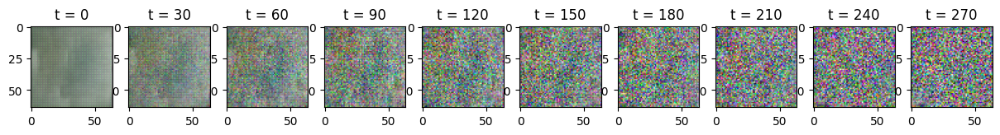

100%|██████████| 58/58 [00:37<00:00,  1.56it/s]


Loss: 0.17352019250392914


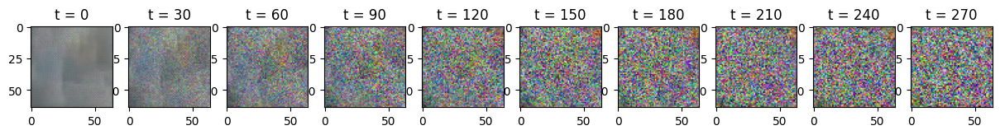

100%|██████████| 58/58 [00:36<00:00,  1.58it/s]


Loss: 0.1842423528432846


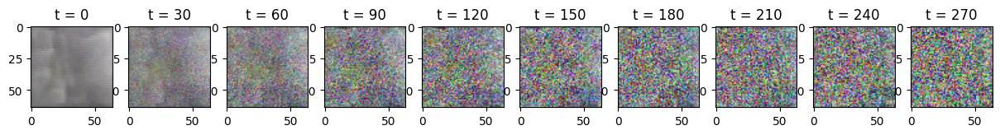

100%|██████████| 58/58 [00:36<00:00,  1.59it/s]


Loss: 0.16638924181461334


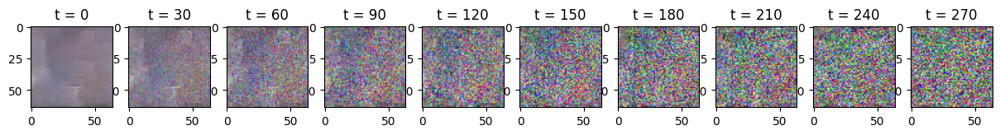

100%|██████████| 58/58 [00:37<00:00,  1.56it/s]


Loss: 0.15375444293022156


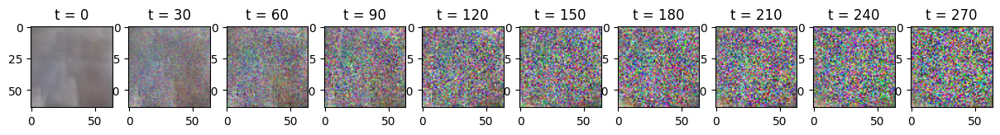

100%|██████████| 58/58 [00:36<00:00,  1.59it/s]


Loss: 0.14790275692939758


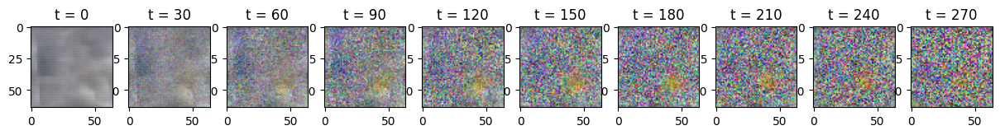

100%|██████████| 58/58 [00:36<00:00,  1.58it/s]


Loss: 0.24254438281059265


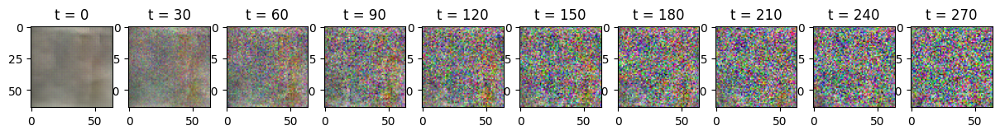

100%|██████████| 58/58 [00:36<00:00,  1.60it/s]


Loss: 0.2017408311367035


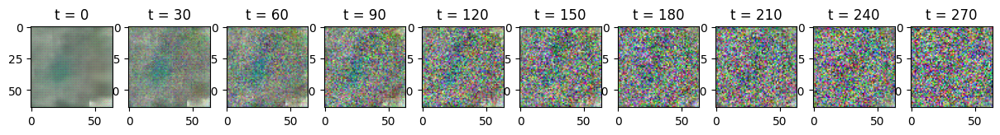

100%|██████████| 58/58 [00:35<00:00,  1.62it/s]


Loss: 0.21056696772575378


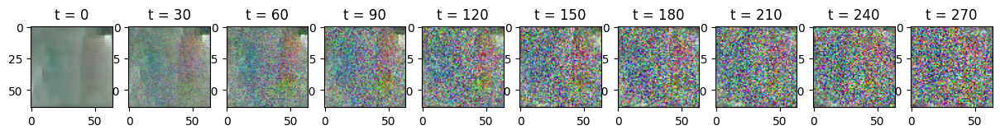

100%|██████████| 58/58 [00:36<00:00,  1.59it/s]


Loss: 0.19527265429496765


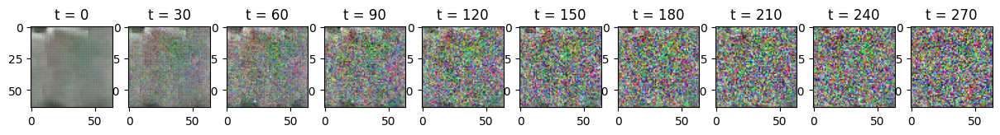

100%|██████████| 58/58 [00:36<00:00,  1.57it/s]


Loss: 0.15022315084934235


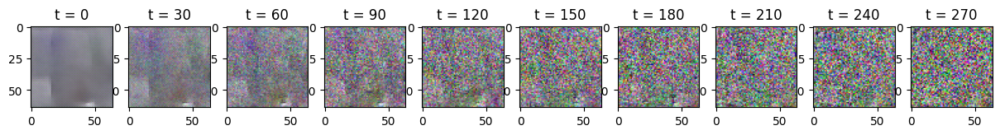

100%|██████████| 58/58 [00:36<00:00,  1.59it/s]


Loss: 0.2036329209804535


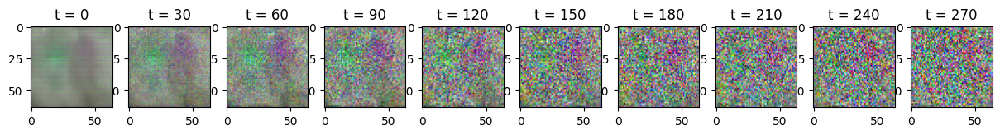

100%|██████████| 58/58 [00:36<00:00,  1.60it/s]


Loss: 0.23889869451522827


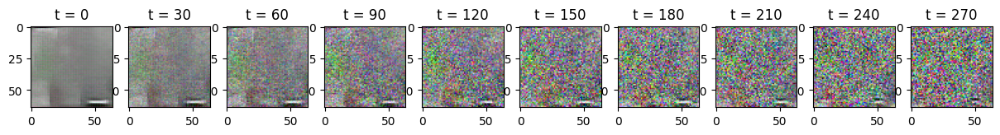

100%|██████████| 58/58 [00:37<00:00,  1.55it/s]


Loss: 0.1831636279821396


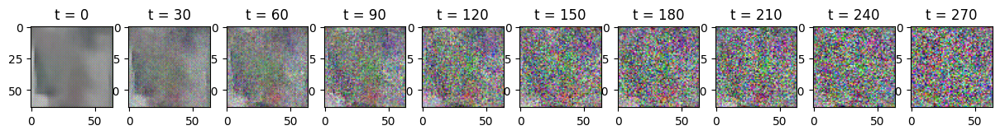

100%|██████████| 58/58 [00:37<00:00,  1.54it/s]


Loss: 0.17767474055290222


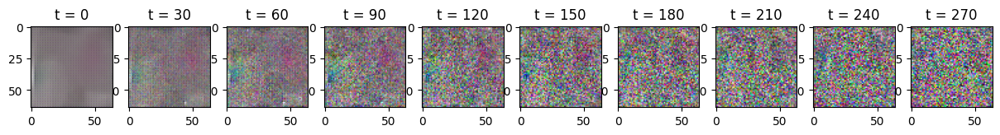

100%|██████████| 58/58 [00:37<00:00,  1.57it/s]


Loss: 0.18794231116771698


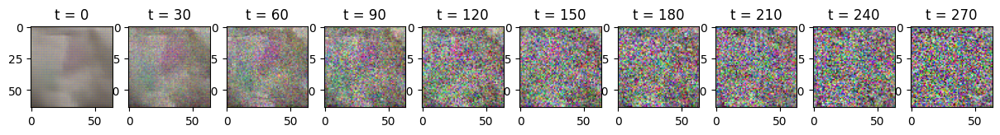

100%|██████████| 58/58 [00:37<00:00,  1.56it/s]


Loss: 0.21863953769207


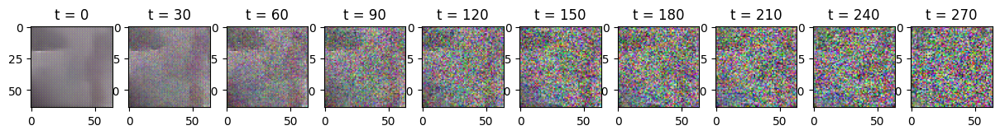

100%|██████████| 58/58 [00:36<00:00,  1.58it/s]


Loss: 0.1726609617471695


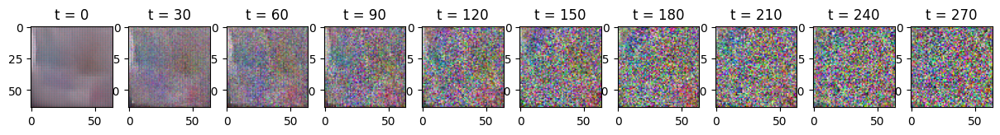

100%|██████████| 58/58 [00:36<00:00,  1.58it/s]


Loss: 0.2088238149881363


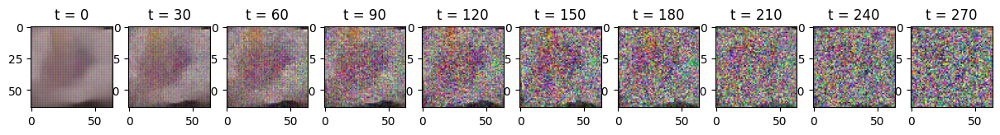

100%|██████████| 58/58 [00:37<00:00,  1.55it/s]


Loss: 0.15861032903194427


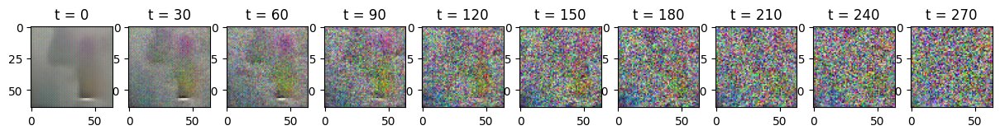

100%|██████████| 58/58 [00:37<00:00,  1.57it/s]


Loss: 0.17991691827774048


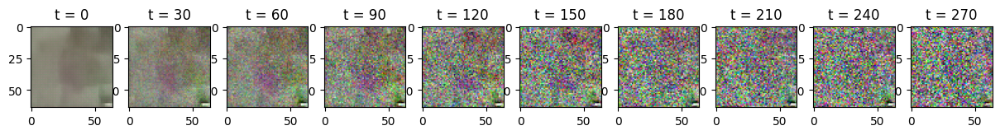

100%|██████████| 58/58 [00:37<00:00,  1.55it/s]


Loss: 0.176166370511055


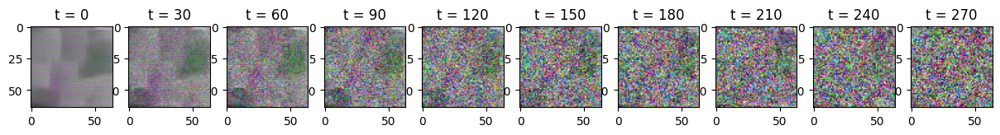

100%|██████████| 58/58 [00:37<00:00,  1.54it/s]


Loss: 0.15120670199394226


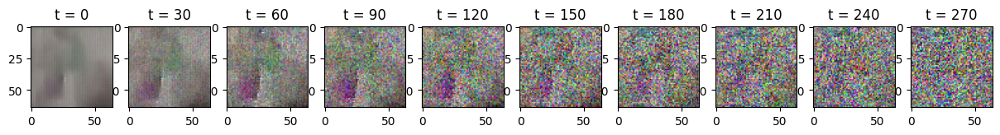

100%|██████████| 58/58 [00:36<00:00,  1.58it/s]


Loss: 0.1345905363559723


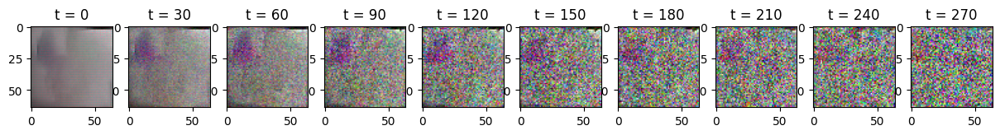

100%|██████████| 58/58 [00:37<00:00,  1.56it/s]


Loss: 0.1903238147497177


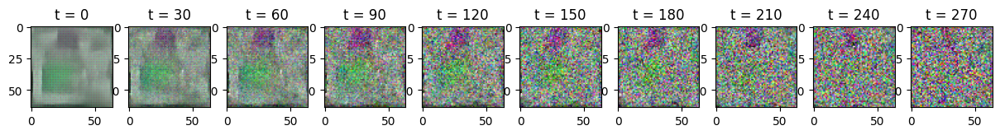

100%|██████████| 58/58 [00:37<00:00,  1.55it/s]


Loss: 0.19774146378040314


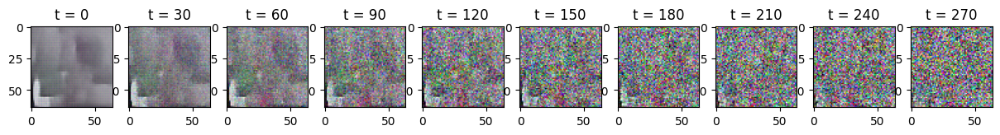

100%|██████████| 58/58 [00:37<00:00,  1.55it/s]


Loss: 0.12858381867408752


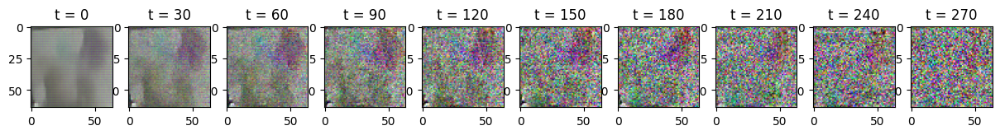

100%|██████████| 58/58 [00:37<00:00,  1.53it/s]


Loss: 0.1512940675020218


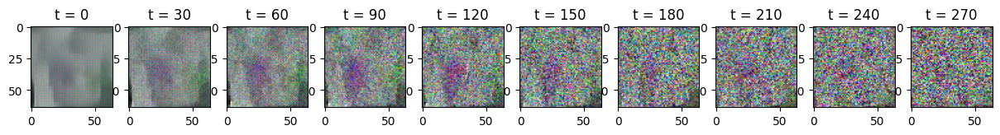

100%|██████████| 58/58 [00:36<00:00,  1.60it/s]


Loss: 0.16477641463279724


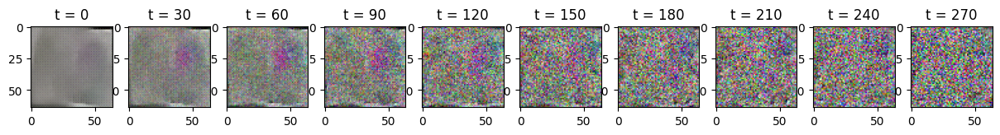

100%|██████████| 58/58 [00:35<00:00,  1.64it/s]


Loss: 0.1442083865404129


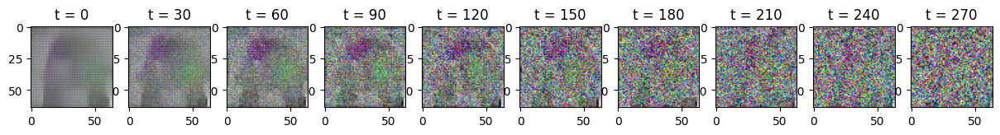

100%|██████████| 58/58 [00:37<00:00,  1.57it/s]


Loss: 0.19126586616039276


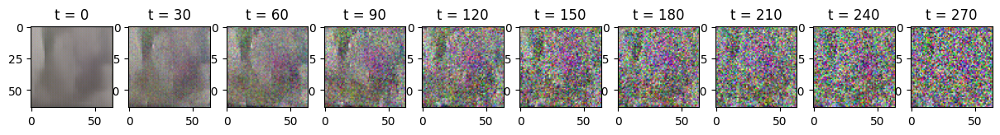

100%|██████████| 58/58 [00:37<00:00,  1.54it/s]


Loss: 0.18192584812641144


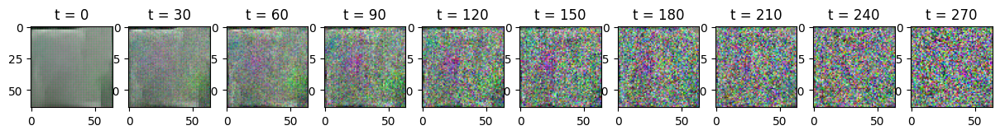

100%|██████████| 58/58 [00:36<00:00,  1.59it/s]


Loss: 0.15587161481380463


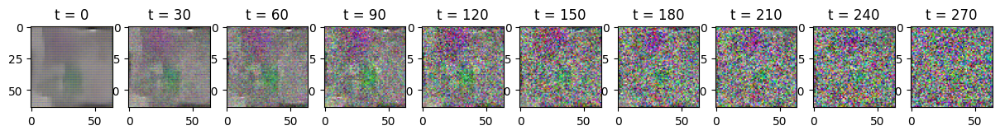

100%|██████████| 58/58 [00:37<00:00,  1.56it/s]


Loss: 0.11670587211847305


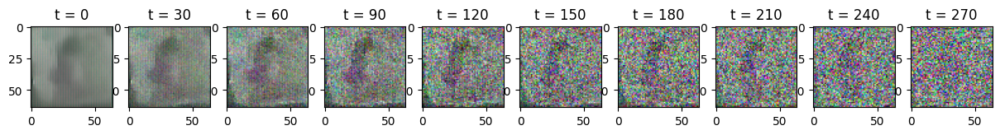

100%|██████████| 58/58 [00:37<00:00,  1.55it/s]


Loss: 0.14284665882587433


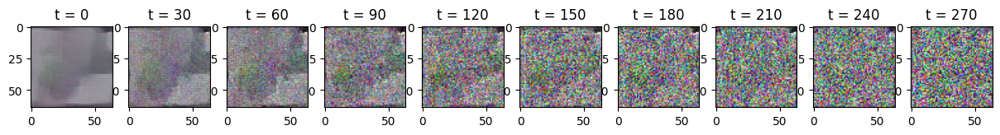

100%|██████████| 58/58 [00:36<00:00,  1.59it/s]


Loss: 0.15687337517738342


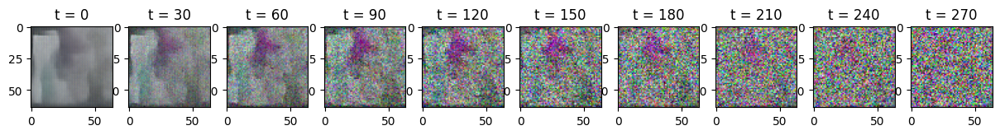

100%|██████████| 58/58 [00:36<00:00,  1.57it/s]


Loss: 0.18222935497760773


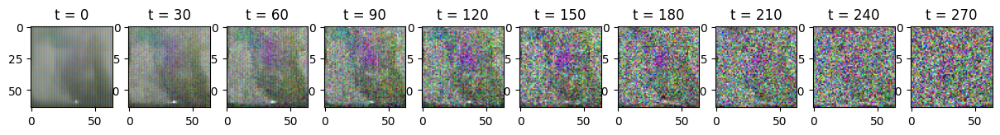

100%|██████████| 58/58 [00:36<00:00,  1.59it/s]


Loss: 0.147396057844162


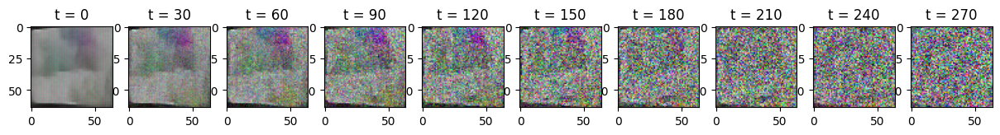

100%|██████████| 58/58 [00:36<00:00,  1.58it/s]


Loss: 0.1635148525238037


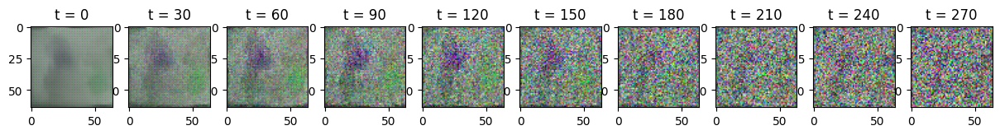

100%|██████████| 58/58 [00:37<00:00,  1.56it/s]


Loss: 0.12451967597007751


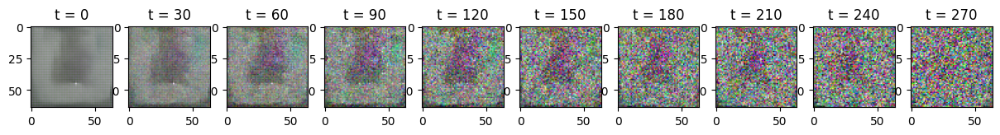

100%|██████████| 58/58 [00:36<00:00,  1.59it/s]


Loss: 0.12081994861364365


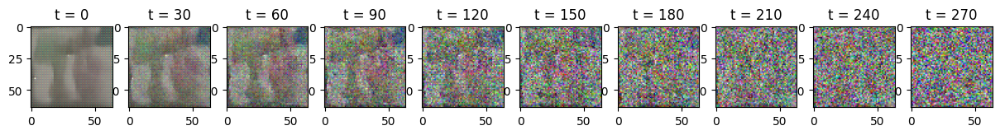

100%|██████████| 58/58 [00:36<00:00,  1.58it/s]


Loss: 0.14630194008350372


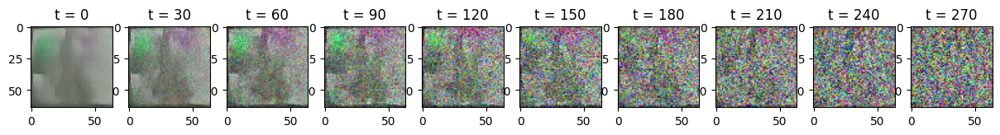

100%|██████████| 58/58 [00:36<00:00,  1.57it/s]


Loss: 0.17868293821811676


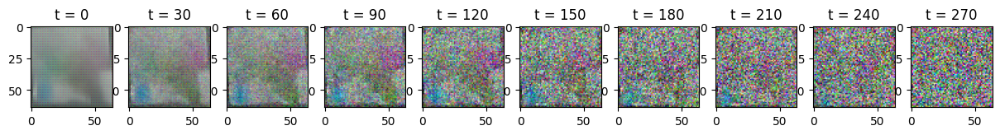

100%|██████████| 58/58 [00:34<00:00,  1.68it/s]


Loss: 0.17691704630851746


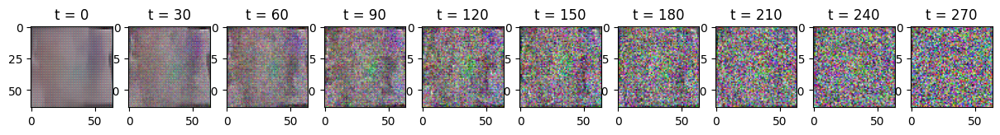

100%|██████████| 58/58 [00:37<00:00,  1.55it/s]


Loss: 0.1172088235616684


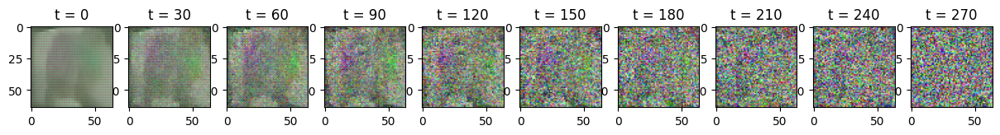

100%|██████████| 58/58 [00:37<00:00,  1.55it/s]


Loss: 0.11689162999391556


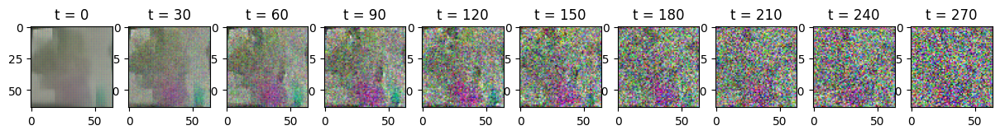

100%|██████████| 58/58 [00:36<00:00,  1.58it/s]


Loss: 0.15472660958766937


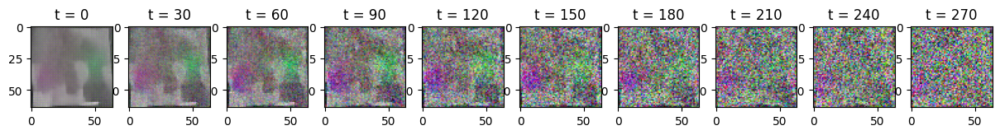

100%|██████████| 58/58 [00:37<00:00,  1.57it/s]


Loss: 0.15910322964191437


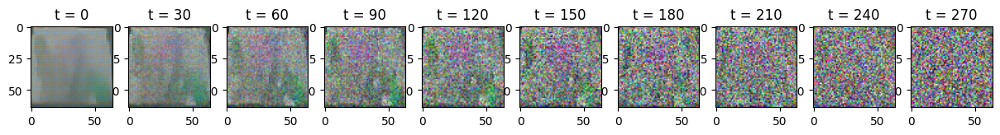

100%|██████████| 58/58 [00:37<00:00,  1.56it/s]


Loss: 0.14800019562244415


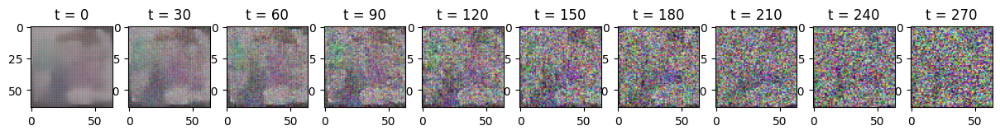

100%|██████████| 58/58 [00:36<00:00,  1.58it/s]


Loss: 0.12583906948566437


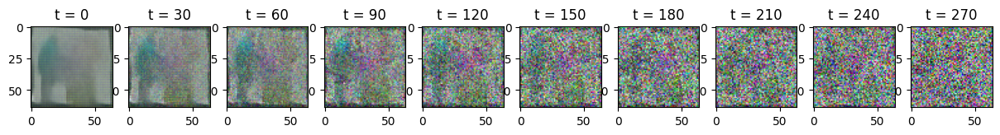

100%|██████████| 58/58 [00:37<00:00,  1.57it/s]


Loss: 0.14884831011295319


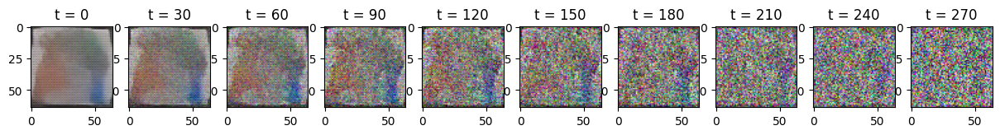

100%|██████████| 58/58 [00:36<00:00,  1.60it/s]


Loss: 0.13750125467777252


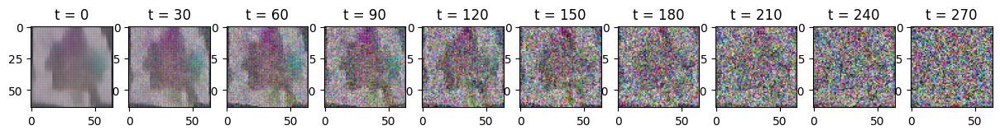

100%|██████████| 58/58 [00:36<00:00,  1.57it/s]


Loss: 0.11717540770769119


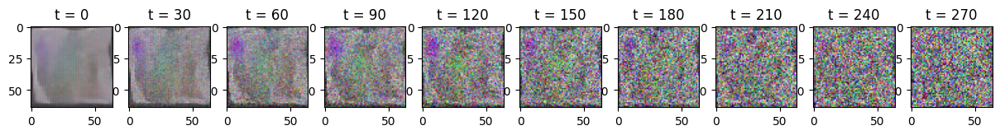

100%|██████████| 58/58 [00:36<00:00,  1.58it/s]


Loss: 0.15196120738983154


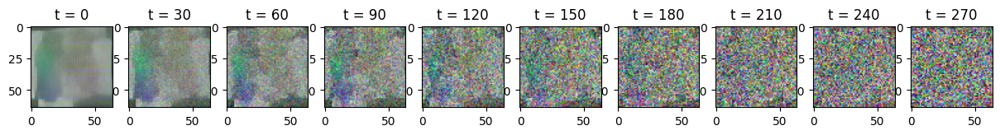

100%|██████████| 58/58 [00:36<00:00,  1.61it/s]


Loss: 0.1600719392299652


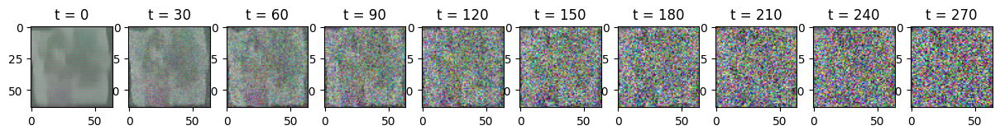

100%|██████████| 58/58 [00:36<00:00,  1.59it/s]


Loss: 0.13288111984729767


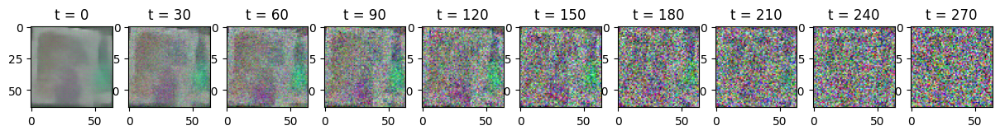

100%|██████████| 58/58 [00:36<00:00,  1.60it/s]


Loss: 0.1734963208436966


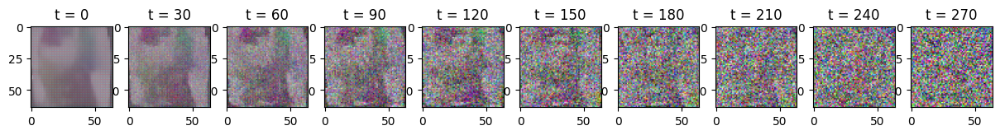

100%|██████████| 58/58 [00:36<00:00,  1.59it/s]


Loss: 0.11393538862466812


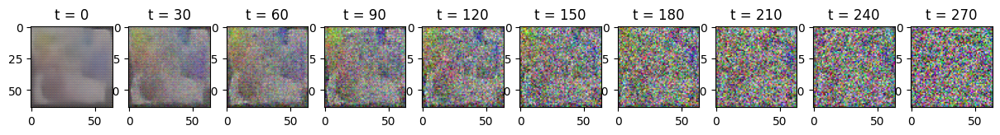

100%|██████████| 58/58 [00:35<00:00,  1.64it/s]


Loss: 0.16969789564609528


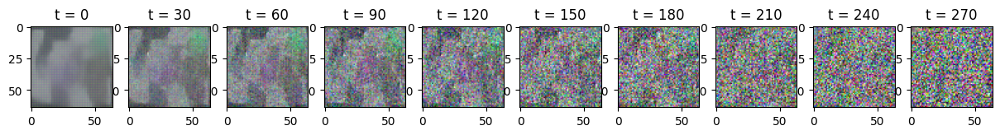

100%|██████████| 58/58 [00:36<00:00,  1.58it/s]


Loss: 0.16582408547401428


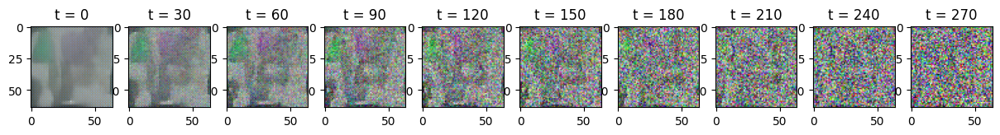

100%|██████████| 58/58 [00:36<00:00,  1.58it/s]


Loss: 0.15805327892303467


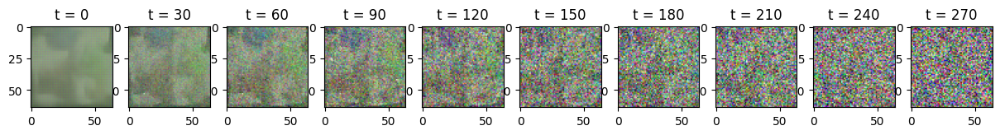

100%|██████████| 58/58 [00:36<00:00,  1.59it/s]


Loss: 0.11234213411808014


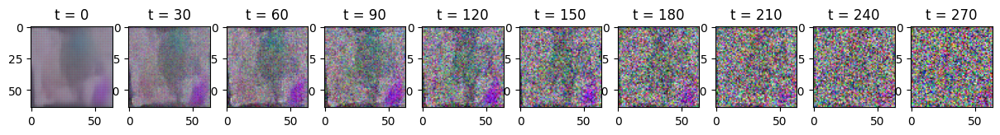

100%|██████████| 58/58 [00:36<00:00,  1.60it/s]


Loss: 0.1401379257440567


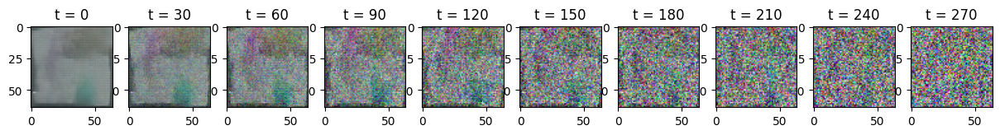

100%|██████████| 58/58 [00:36<00:00,  1.57it/s]


Loss: 0.15873731672763824


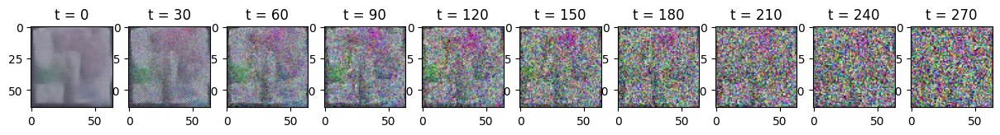

100%|██████████| 58/58 [00:36<00:00,  1.58it/s]


Loss: 0.1662595272064209


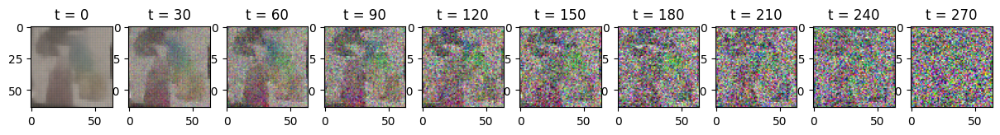

100%|██████████| 58/58 [00:36<00:00,  1.59it/s]


Loss: 0.1593119204044342


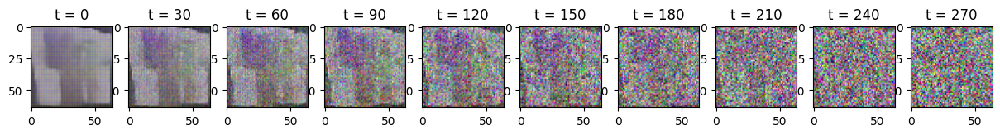

100%|██████████| 58/58 [00:36<00:00,  1.58it/s]


Loss: 0.12017937749624252


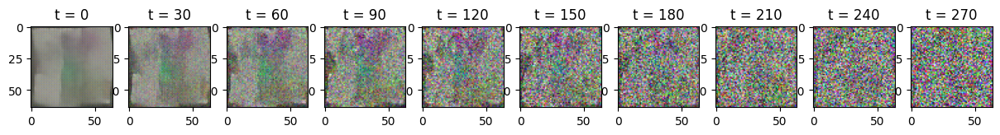

100%|██████████| 58/58 [00:36<00:00,  1.60it/s]


Loss: 0.10943982005119324


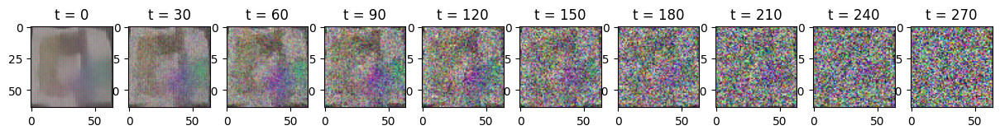

100%|██████████| 58/58 [00:37<00:00,  1.56it/s]


Loss: 0.1970057636499405


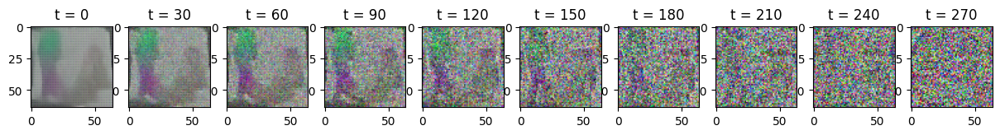

100%|██████████| 58/58 [00:37<00:00,  1.56it/s]


Loss: 0.16229699552059174


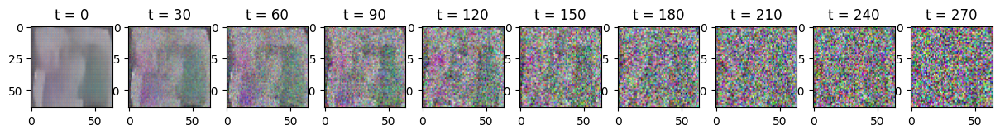

100%|██████████| 58/58 [00:37<00:00,  1.56it/s]


Loss: 0.10966036468744278


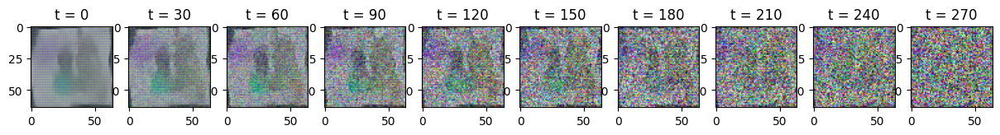

100%|██████████| 58/58 [00:37<00:00,  1.57it/s]


Loss: 0.11983582377433777


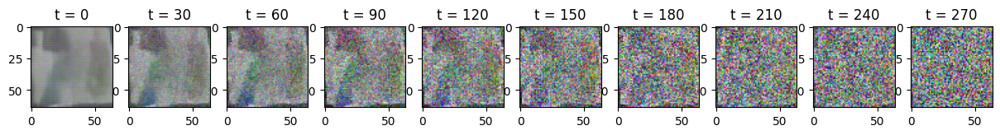

100%|██████████| 58/58 [00:34<00:00,  1.68it/s]


Loss: 0.16280347108840942


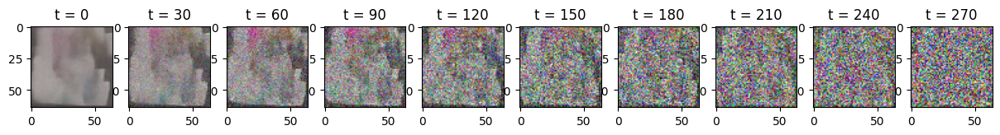

100%|██████████| 58/58 [00:35<00:00,  1.61it/s]


Loss: 0.12438036501407623


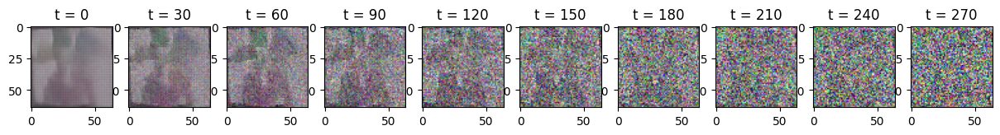

100%|██████████| 58/58 [00:36<00:00,  1.57it/s]


Loss: 0.1376819908618927


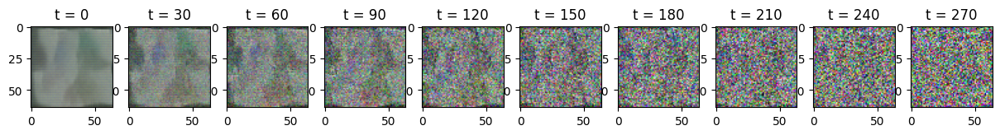

100%|██████████| 58/58 [00:36<00:00,  1.57it/s]


Loss: 0.11949063092470169


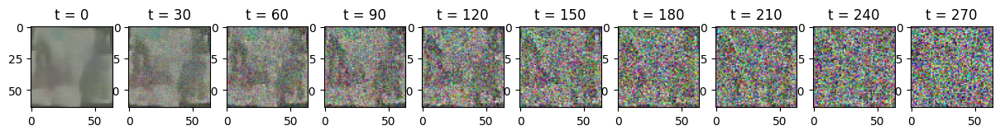

100%|██████████| 58/58 [00:36<00:00,  1.57it/s]


Loss: 0.11063794791698456


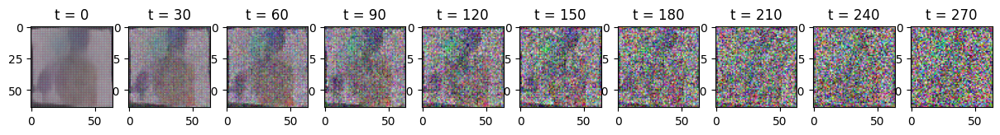

100%|██████████| 58/58 [00:36<00:00,  1.58it/s]


Loss: 0.14745627343654633


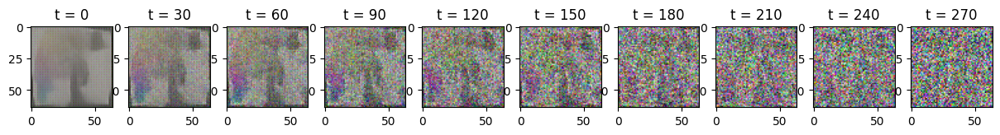

100%|██████████| 58/58 [00:35<00:00,  1.61it/s]


Loss: 0.22381237149238586


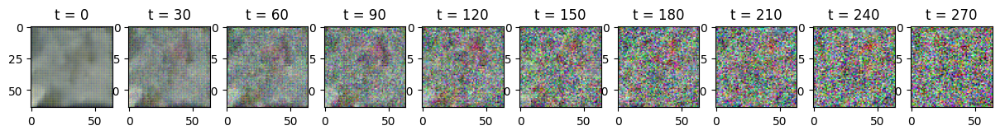

100%|██████████| 58/58 [00:36<00:00,  1.58it/s]


Loss: 0.178268700838089


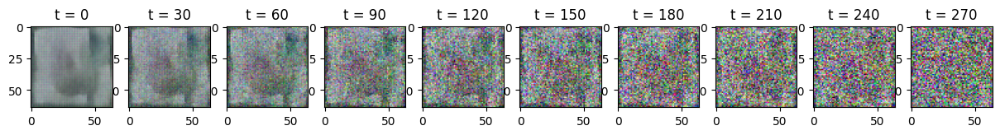

100%|██████████| 58/58 [00:37<00:00,  1.56it/s]


Loss: 0.2031334489583969


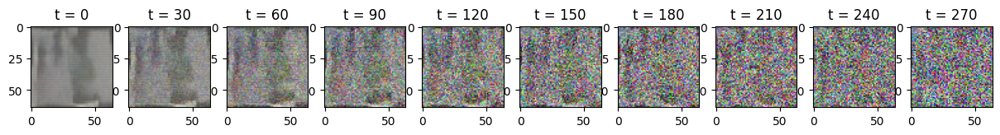

100%|██████████| 58/58 [00:36<00:00,  1.58it/s]


Loss: 0.13400150835514069


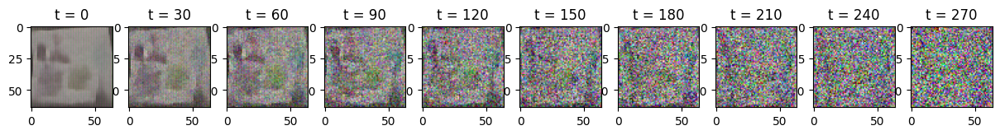

100%|██████████| 58/58 [00:36<00:00,  1.58it/s]


Loss: 0.12127138674259186


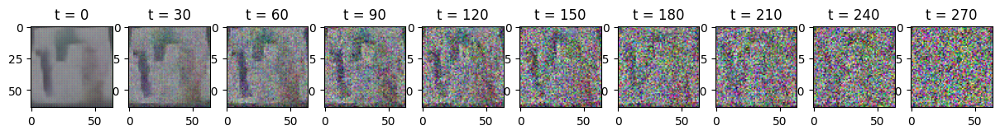

100%|██████████| 58/58 [00:35<00:00,  1.62it/s]


Loss: 0.1853758841753006


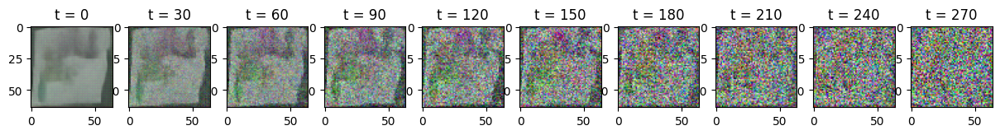

100%|██████████| 58/58 [00:36<00:00,  1.58it/s]


Loss: 0.18611770868301392


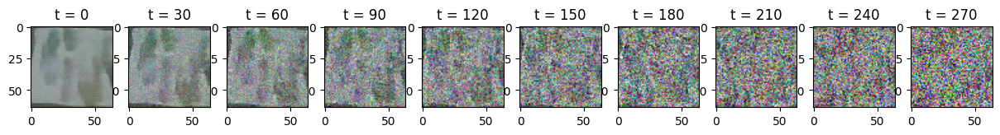

100%|██████████| 58/58 [00:37<00:00,  1.56it/s]


Loss: 0.11570907384157181


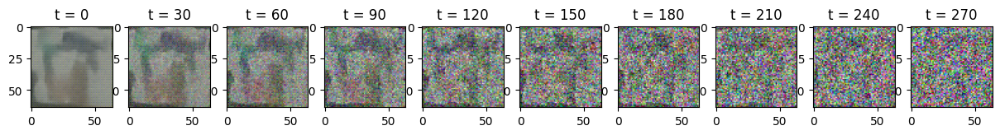

100%|██████████| 58/58 [00:36<00:00,  1.61it/s]


Loss: 0.13820980489253998


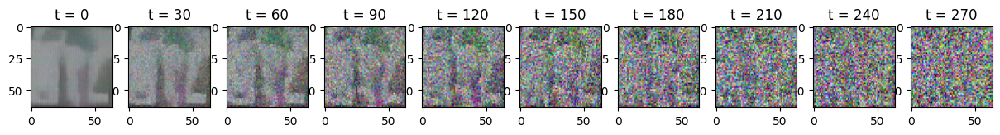

100%|██████████| 58/58 [00:35<00:00,  1.62it/s]


Loss: 0.11599559336900711


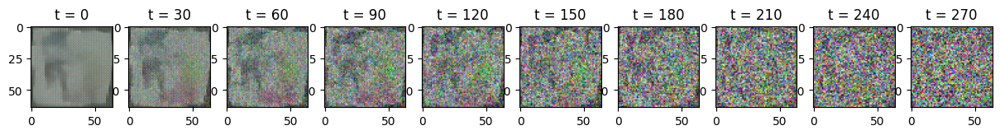

100%|██████████| 58/58 [00:37<00:00,  1.57it/s]


Loss: 0.129652202129364


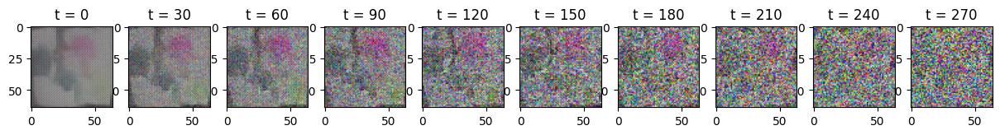

100%|██████████| 58/58 [00:36<00:00,  1.59it/s]


Loss: 0.11435112357139587


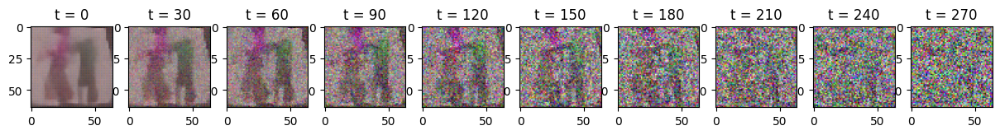

100%|██████████| 58/58 [00:36<00:00,  1.59it/s]


Loss: 0.16728617250919342


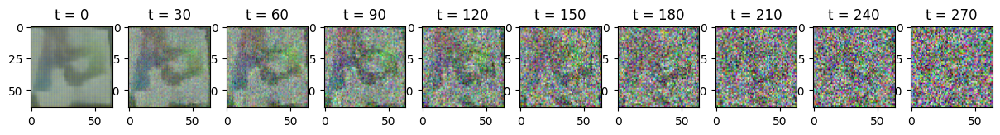

100%|██████████| 58/58 [00:36<00:00,  1.58it/s]


Loss: 0.10675890743732452


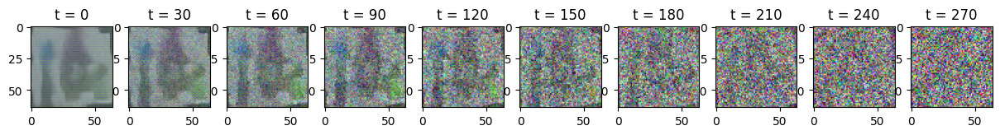

100%|██████████| 58/58 [00:37<00:00,  1.56it/s]


Loss: 0.15089985728263855


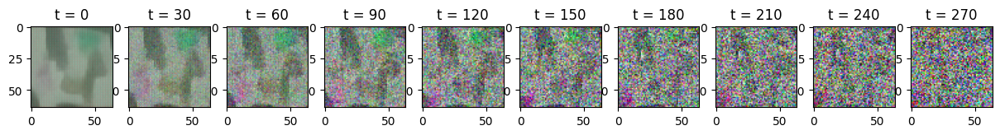

100%|██████████| 58/58 [00:36<00:00,  1.58it/s]


Loss: 0.1106724813580513


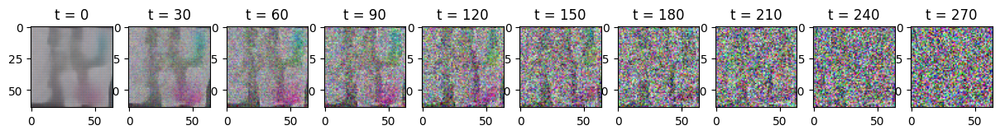

100%|██████████| 58/58 [00:36<00:00,  1.59it/s]


Loss: 0.1015934869647026


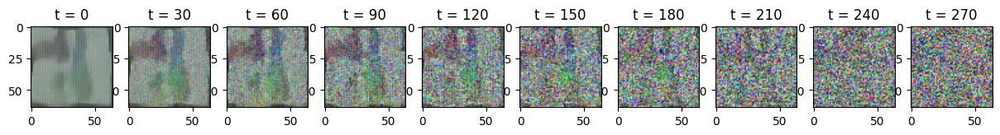

100%|██████████| 58/58 [00:36<00:00,  1.58it/s]


Loss: 0.10502710938453674


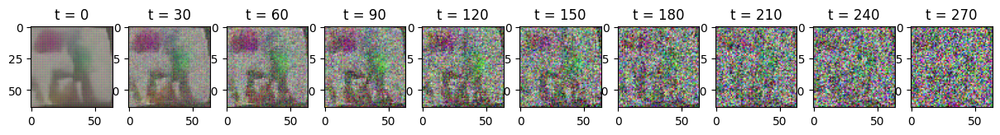

100%|██████████| 58/58 [00:36<00:00,  1.58it/s]


Loss: 0.11067567020654678


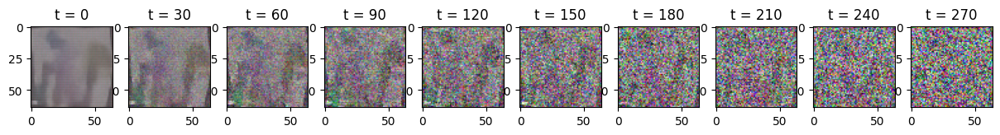

100%|██████████| 58/58 [00:36<00:00,  1.57it/s]


Loss: 0.10989167541265488


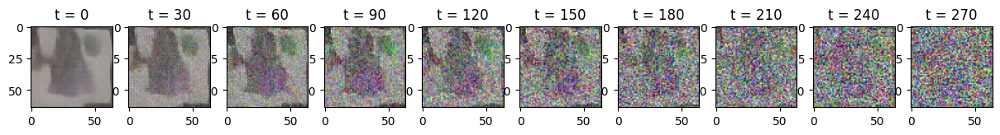

100%|██████████| 58/58 [00:37<00:00,  1.57it/s]


Loss: 0.11607830971479416


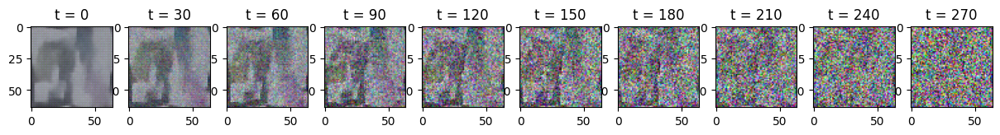

100%|██████████| 58/58 [00:37<00:00,  1.57it/s]


Loss: 0.16420401632785797


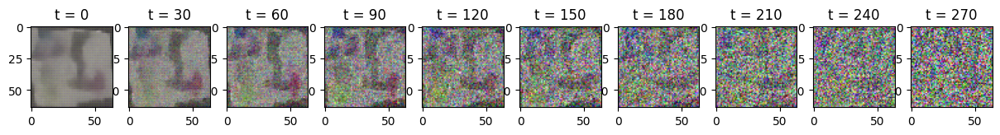

AttributeError: 'SummaryWriter' object has no attribute 'Close'

In [39]:
num_epochs = 100
batch_size = 32
writer = SummaryWriter(log_dir='/content/logs')

for epoch in range(num_epochs):
  epoch_loss = 0
  num_batches = 0
  for input_image, _ in tqdm(dataloader):
    optimizer.zero_grad()
    t = torch.randint(0, T, (input_image.shape[0],), device=device).long()
    input_image = input_image.to(device)
    #print(input_image.shape)

    x_noisy, noise = fdp.forward_diffusion_sample(input_image, t)  #Get noisy image and corresponding noise
    model_noise_pred = unet_model(x_noisy, t)  #Predict the noise using the UNet model
    loss = F1_loss(noise, model_noise_pred)  #Compute L1 loss between actual noise and predicted noise
    loss.backward()
    optimizer.step()

    epoch_loss += loss.item()
    num_batches += 1

  ##logging average loss   
  avg_loss = epoch_loss / num_batches
  writer.add_scalar('Loss/train', avg_loss, epoch)  #Logging average loss per epoch to tensorboard
    
  print(f'Loss: {loss.item()}')
  sample_image()

writer. Close()